In [536]:
%pip install numpy opencv-python-headless scikit-image scipy matplotlib seaborn pandas
import cv2
import numpy as np
from skimage import measure, segmentation
from scipy import ndimage

import matplotlib.pyplot as plt

  Obtaining dependency information for opencv-python-headless from https://files.pythonhosted.org/packages/1c/9b/583c8d9259f6fc19413f83fd18dd8e6cbc8eefb0b4dc6da52dd151fe3272/opencv_python_headless-4.10.0.84-cp37-abi3-macosx_11_0_arm64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.8/54.8 MB 35.4 MB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.2.1 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [523]:
# load images, B&W
def load_images(image_dir, use_color = False):
    
  filepaths = []
  for filename in os.listdir(image_dir):
    if filename.endswith(".jpg"):
      filepaths.append(os.path.join(image_dir, filename))
    filepaths.sort()
  return [cv2.imread(img_path, cv2.IMREAD_COLOR if use_color else cv2.IMREAD_GRAYSCALE) for img_path in filepaths]
  
def plot_images(images, horiz=False, figsize=None):
  fig, axes = plt.subplots(len(images), 1, figsize=figsize) if not horiz else \
        plt.subplots(1, len(images), figsize=figsize)
  for ax, img in zip(axes, images):
    ax.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax.axis('off')
  plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
  plt.show()
def plot_images_2(images, horiz=False, figsize=None):
  fig, axes = plt.subplots(len(images), 1, figsize=figsize) if not horiz else \
        plt.subplots(1, len(images), figsize=figsize)
  for ax, img in zip(axes, images):
    ax.imshow(img, cmap='jet')
    ax.axis('off')
  plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
  plt.show()
def crop_out_dish(img):
  height, width = img.shape
  center = (1009,575)
  radius = 389
  Y, X = np.ogrid[:height, :width]
  dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
  mask = dist_from_center <= radius
  img[~mask] = 0
  return img

def crop_out_dish_colored(img):
  height, width,_ = img.shape
  center = (1009,575)
  radius = 389
  Y, X = np.ogrid[:height, :width]
  dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
  mask = dist_from_center <= radius
  img_copy = img.copy()
  img_copy[~mask] = 0
  return img_copy

"""
Images should have already been segmented at this point
"""
def filter_and_label_bw_images(images,min_size = 0):
  labeled_images = []
  for img in images:
    # Label connected components (colonies)
    labeled_image, num_colonies = ndimage.label(img)
    # Remove small objects
    # labeled_image = measure.label(segmentation.clear_border(labeled_image))
    props = measure.regionprops(labeled_image)
    for prop in props:
      # print(f"Label: {prop.label}, {prop.label}, Area: Area: {prop.area}, {prop.area}, Centroid: Centroid: {prop.centroid}")

      if prop.area < min_size or prop.area > 460000: # approximately dish size
        labeled_image[labeled_image == prop.label] = 0
        continue
    labeled_image, num_colonies = ndimage.label(labeled_image)
    props = measure.regionprops(labeled_image) # new (filtered out) regions
    assert len(props) == num_colonies
    
    labeled_images.append({"image":labeled_image,"regions":props})
  return labeled_images

def score_count(reference_regions, found_regions):
  pass

def score_area(reference_regions, found_regions):
  pass

# Loading in images

loaded 3 actual images
loaded 3 reference images


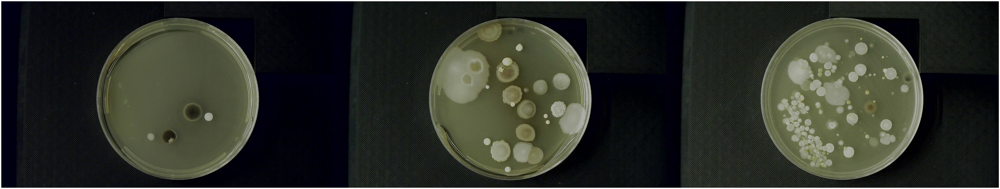

In [524]:
import os

imgs = load_images("test")
colored_imgs = load_images("test",use_color=True)
reference_images = load_images("manual")
print(f"loaded {len(imgs)} actual images")
print(f"loaded {len(reference_images)} reference images")
plot_images(colored_imgs,horiz=True,figsize=(100,40))


## Image pre-processing

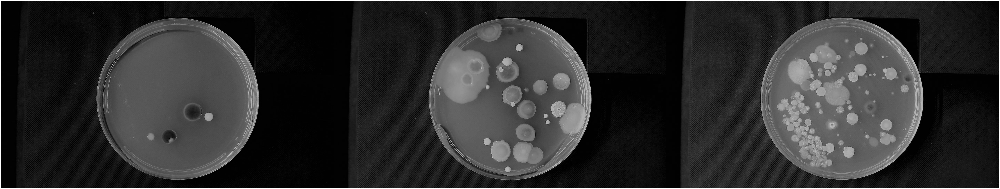

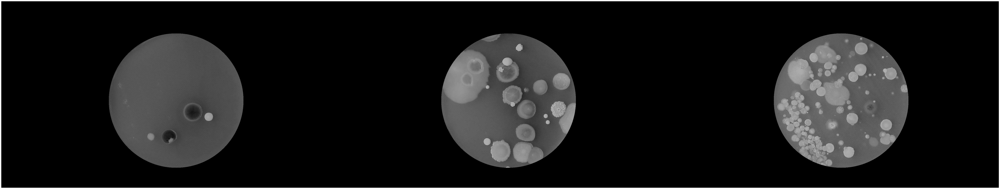

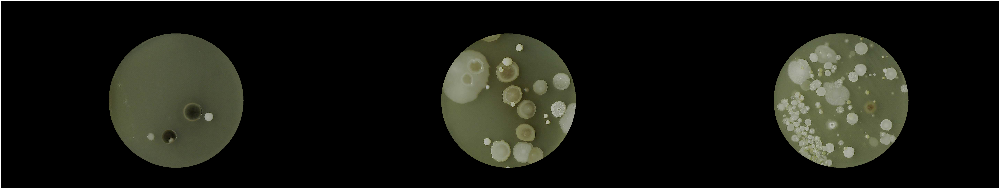

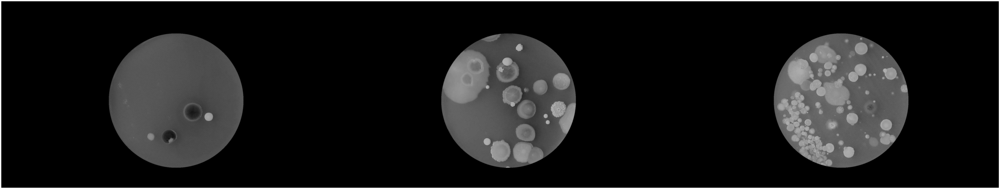

In [525]:
cropped_images = []
colored_cropped_images = []
blurred_and_cropped_images = []
plot_images(imgs,horiz=True,figsize=(100,40))
for i in range(len(imgs)):
  # Crop out circle in blurred
  cropped_images.append(crop_out_dish(imgs[i]))
  colored_cropped_images.append(crop_out_dish_colored(colored_imgs[i]))
  blurred_and_cropped_images.append(cv2.GaussianBlur(cropped_images[-1], (5, 5), 0))
plot_images(cropped_images,horiz=True,figsize=(100,40))
plot_images(colored_cropped_images,horiz=True,figsize=(100,40))
plot_images(blurred_and_cropped_images,horiz=True,figsize=(100,40))


# Thresholding

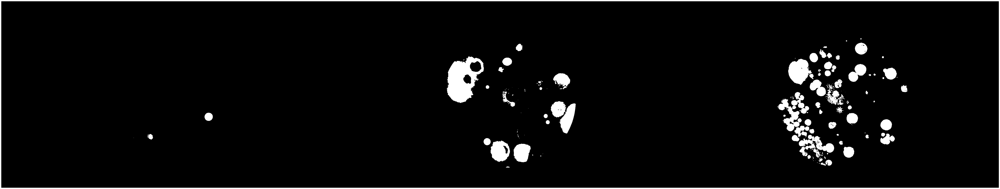

In [526]:
def find_threshold(img):
  return max(130,np.quantile(img, 0.95)) # in case there are very few colonies in the image, we still want the threshold to be somewhat reasonable


threshed_images = [cv2.threshold(image, find_threshold(image), 255, cv2.THRESH_BINARY)[1] for image in blurred_and_cropped_images]
plot_images(threshed_images,horiz=True,figsize=(100,277))



## Label regions in thresholded images

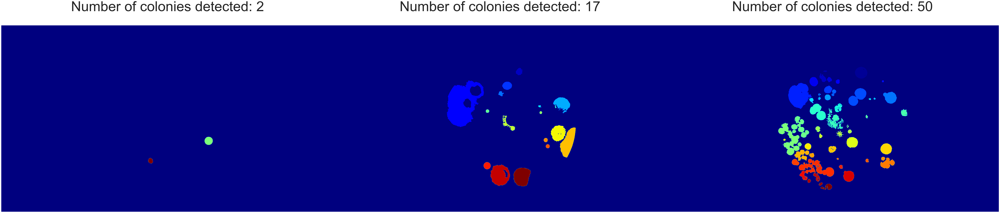

In [527]:
labeled_thresholded_images = filter_and_label_bw_images(threshed_images,min_size=100)

fig, axes = plt.subplots(1, len(labeled_thresholded_images), figsize=(100, 40))
for ax, img_dict in zip(axes, labeled_thresholded_images):
  img, props = img_dict["image"], img_dict["regions"]
  ax.imshow(img, cmap='jet')
  ax.set_title(f'Number of colonies detected: {len(props)}', fontsize=78, pad=80)
  ax.axis('off')
# fig.suptitle('Labeled Thresholded Images', fontsize=16)
plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
plt.show()


# Label regions of manual annotations

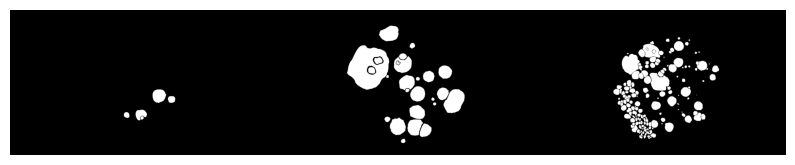

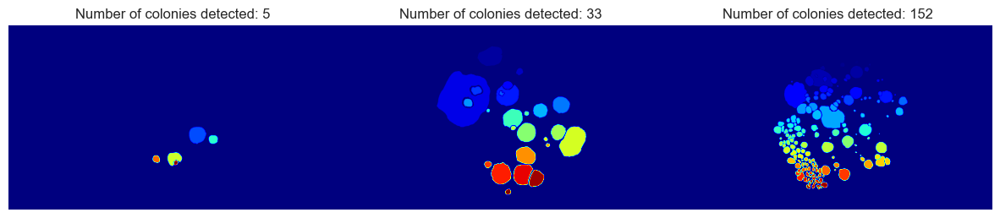

In [528]:

reference_threshed = [cv2.threshold(image, 100, 255, cv2.THRESH_BINARY_INV)[1] for image in reference_images]
labeled_reference_images = filter_and_label_bw_images(reference_threshed)
plot_images(reference_threshed,horiz=True,figsize=(10,10))
fig, axes = plt.subplots(1, len(labeled_reference_images), figsize=(15, 5))
for ax, img_dict in zip(axes, labeled_reference_images):
  img, props = img_dict["image"], img_dict["regions"]
  ax.imshow(img, cmap='jet')  # Visualize the labeled colonies with an alternative colormap
  ax.set_title(f'Number of colonies detected: {len(props)}')
  ax.axis('off')
plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
plt.show()


# Oversegmentation

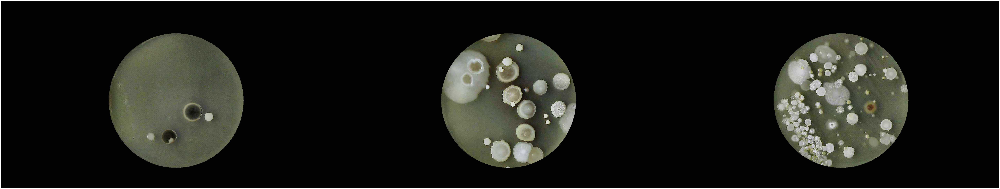

In [529]:
from skimage.segmentation import felzenszwalb
from skimage import graph
import skimage

def increase_contrast(img, clip_limit=2.0, tile_grid_size=(8, 8)):
  clahe = cv2.createCLAHE(clipLimit=clip_limit, tileGridSize=tile_grid_size)
  if len(img.shape) == 2:  # Grayscale image
    return clahe.apply(img)
  elif len(img.shape) == 3:  # Color image
    channels = cv2.split(img)
    eq_channels = [clahe.apply(channel) for channel in channels]
    return cv2.merge(eq_channels)

contrasted_images = [increase_contrast(img) for img in colored_cropped_images]
plot_images(contrasted_images, horiz=True, figsize=(100, 40))
image_segments = [felzenszwalb(img, scale=200, sigma=0, min_size=50) for img in contrasted_images] # scale was 300

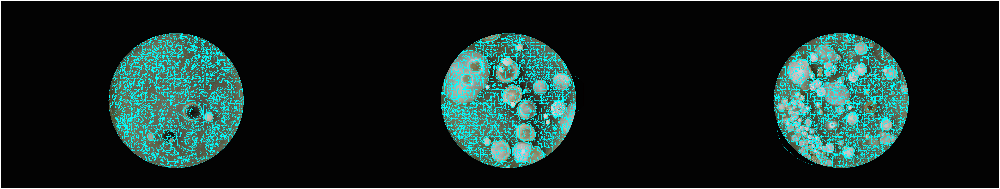

In [530]:
from skimage.segmentation import mark_boundaries

# Superimpose image_segments on contrasted_images
superimposed_images = [mark_boundaries(image, segments) for image, segments in zip(contrasted_images, image_segments)]

# Convert images to uint8 for plotting
superimposed_images_uint8 = [cv2.convertScaleAbs(img, alpha=(255.0/img.max())) for img in superimposed_images]

# Plot the superimposed images
plot_images(superimposed_images_uint8, horiz=True, figsize=(100, 40))


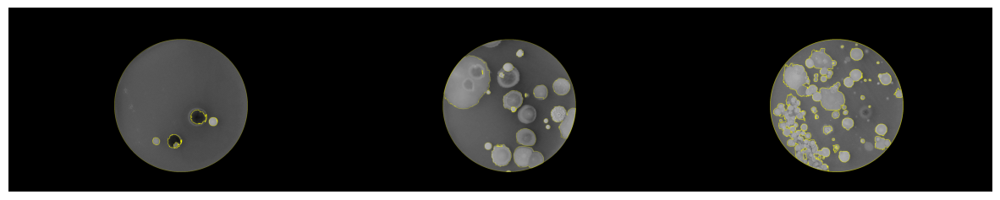

In [531]:
import skimage
# reference used: https://scikit-image.org/docs/stable/auto_examples/segmentation/plot_rag_merge.html

def _unused_calc_weight_mean_color(mean_0, mean_1):
    diff = mean_0 - mean_1
    diff = np.linalg.norm(diff)
    return diff
def _unused_merge_boundary(graph, src, dst):
    """Call back called before merging 2 nodes.

    In this case we don't need to do any computation here.
    """
    pass


def _unused_weight_boundary(graph, src, dst, n):
    """
    Handle merging of nodes of a region boundary region adjacency graph.

    This function computes the `"weight"` and the count `"count"`
    attributes of the edge between `n` and the node formed after
    merging `src` and `dst`.


    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the "weight" and "count" attributes to be
        assigned for the merged node.

    """
    default = {'weight': 0.0, 'count': 0}
    # print(graph[src])
    # print(src)
    # print(graph[src].get(n, default))
    print(graph[src].get(n, default))
    count_src = 1 or graph[src].get(n, default)['count']
    count_dst = 1 or graph[dst].get(n, default)['count']

    weight_src = graph[src].get(n, default)['weight']
    weight_dst = graph[dst].get(n, default)['weight']
    # print(graph[src].get(dst))
    # count = count_src + count_dst
    return {
        # 'count': count,
        'weight': calc_weight_mean_color(weight_src ,weight_dst),
    }

def _weight_mean_color(graph, src, dst, n):
    """Callback to handle merging nodes by recomputing mean color.

    The method expects that the mean color of `dst` is already computed.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the `"weight"` attribute set as the absolute
        difference of the mean color between node `dst` and `n`.
    """

    diff = graph.nodes[dst]['mean color'] - graph.nodes[n]['mean color']
    diff = np.linalg.norm(diff)
    return {'weight': diff}


def merge_mean_color(graph, src, dst):
    """Callback called before merging two nodes of a mean color distance graph.

    This method computes the mean color of `dst`.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    """
    graph.nodes[dst]['total color'] += graph.nodes[src]['total color']
    graph.nodes[dst]['pixel count'] += graph.nodes[src]['pixel count']
    graph.nodes[dst]['mean color'] = (
        graph.nodes[dst]['total color'] / graph.nodes[dst]['pixel count']
    )

merged_segments = [graph.merge_hierarchical(image_segment, graph.rag_mean_color(image, image_segment), thresh=50, rag_copy=False,
                                           in_place_merge=True,
                                           merge_func=merge_mean_color,
                                           weight_func=_weight_mean_color) for (image,image_segment) in zip(cropped_images,image_segments)]
# plot_images(merged_segments)
fig, axes = plt.subplots(1, len(cropped_images), figsize=(15, 5))
plt.subplots_adjust(wspace=0, hspace=0)  # Remove gaps between subplots
for ax, cropped_image, merged_segment in zip(axes, cropped_images, merged_segments):
    ax.imshow(skimage.segmentation.mark_boundaries(cropped_image, merged_segment))
    ax.axis('off')

plt.show()

# print(merged_segments)

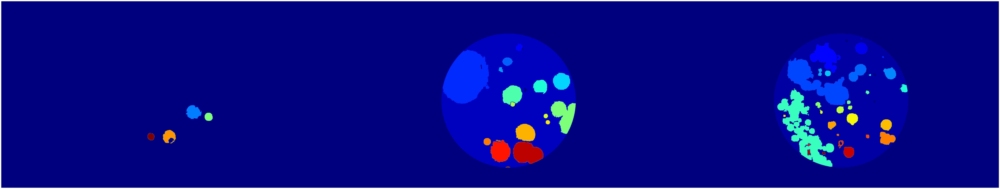

In [532]:
# Turn segments into regions of black on a white background
inverted_segments = [255 - skimage.segmentation.mark_boundaries(np.zeros_like(img), segment, color=(255, 255, 255)) for img, segment in zip(cropped_images, merged_segments)]
# plot_images(inverted_segments,figsize=(100,10))
filled_segments = [cv2.cvtColor(segment.astype(np.uint8), cv2.COLOR_BGR2GRAY) for segment in inverted_segments]
# captured_regions = [measure.label(segment) for segment in filled_segments]

labeled_oversegmented_images = filter_and_label_bw_images(filled_segments,min_size=100)
# plot_images(captured_regions, figsize=(100, 10))

# Extract the "image" key from each dictionary
labeled_oversegmented_images_data = [img_dict["image"] for img_dict in labeled_oversegmented_images]

# Convert images to a supported depth before plotting
plot_images_2(labeled_oversegmented_images_data, horiz=True, figsize=(100, 100))


# Analyzing performance

In [537]:
from scipy.optimize import linear_sum_assignment
import math

print([len(d["regions"]) for d in labeled_thresholded_images])
print([len(d["regions"]) for d in labeled_oversegmented_images])
print([len(d["regions"]) for d in labeled_reference_images])

def distance(a,b):

  x1,y1 = a
  x2,y2 = b
  dist = math.sqrt((x2-x1)*(x2-x1)+(y2-y1)*(y2-y1))
  return dist

def score_area(regions,reference_regions):
  centroids = [region.centroid for region in regions]
  reference_centroids = [region.centroid for region in reference_regions]

  matrix = []
  matrix_i_to_region_i_map = {}

  for i in range(len(centroids)):
    next_row = []
    for j in range(len(reference_centroids)):
      next_row.append(distance(centroids[i],reference_centroids[j]) )
    # print(matrix[-1])
    if all(dist>30 for dist in next_row):
      pass
      # print("skipping",i) # region too far from all other regions... likely not it
    else:
      matrix.append(next_row)
      matrix_i_to_region_i_map[len(matrix)-1] = i # so we can get back the actual region index based on matrix index

  row_ind, col_ind = linear_sum_assignment(matrix) # match centroids for minimum pairwise distance sum
  row_to_col_map = {matrix_i_to_region_i_map[i]: j for i, j in zip(row_ind, col_ind) if i in matrix_i_to_region_i_map}

  area_difference = 0
  centroid_dists = 0
  seen_reference_area_indices = set()
  overcount = 0
  undercount = 0
  for region_i in range(len(centroids)):
    area = regions[region_i].area
    # print(area,reference_area)
    if region_i in row_to_col_map:
      reference_area = reference_regions[row_to_col_map[region_i]].area
      area_difference += abs(area-reference_area)
      seen_reference_area_indices.add(row_to_col_map[region_i])
      centroid_dists+=distance(centroids[region_i],reference_centroids[row_to_col_map[region_i]])
    else:
      # centroid_dists+=distance(centroids[region_i],(0,0))
      area_difference+=area
      overcount+=1
  
  for region_i in range(len(reference_regions)):
    if region_i not in seen_reference_area_indices:
      area_difference+=reference_regions[region_i].area
      # centroid_dists+=distance(reference_regions[region_i].centroid,(0,0))
      undercount+=1
  return area_difference/len(reference_regions),overcount,undercount,centroid_dists/len(reference_regions)

# first is threshold, second is oversegmentation
colony_count_delta = [[],[]]
area_score = [[],[]]
centroid_score = [[],[]]

if len(labeled_thresholded_images) == len(labeled_reference_images):
  for i in range(len(labeled_reference_images)):
    threshold_score, threshold_over, threshold_under, threshold_centroid_dists = score_area(labeled_thresholded_images[i]["regions"], labeled_reference_images[i]["regions"])

    oversegmented_score, oversegmented_over, oversegmented_under, oversegmented_centroid_dists = score_area(labeled_oversegmented_images[i]["regions"], labeled_reference_images[i]["regions"])

    print(f"Thresholding - Score: {threshold_score}, Over: {threshold_over}, Under: {threshold_under}, Centroid Distances: {threshold_centroid_dists}")
    print(f"Oversegmentation - Score: {oversegmented_score}, Over: {oversegmented_over}, Under: {oversegmented_under}, Centroid Distances: {oversegmented_centroid_dists}")
    colony_count_delta[0].append((len(labeled_thresholded_images[i]["regions"]) - len(labeled_reference_images[i]["regions"]))/len(labeled_reference_images[i]["regions"]))
    colony_count_delta[1].append((len(labeled_oversegmented_images[i]["regions"]) - len(labeled_reference_images[i]["regions"]))/len(labeled_reference_images[i]["regions"]))
    area_score[0].append(threshold_score)
    area_score[1].append(oversegmented_score)
    centroid_score[0].append(threshold_centroid_dists)
    centroid_score[1].append(oversegmented_centroid_dists)

[2, 17, 50]
[4, 18, 31]
[5, 33, 152]
Thresholding - Score: 2755.4, Over: 0, Under: 3, Centroid Distances: 0.7941247107965037
Oversegmentation - Score: 857.2, Over: 0, Under: 1, Centroid Distances: 2.0900389327339814
Thresholding - Score: 5684.606060606061, Over: 2, Under: 18, Centroid Distances: 5.263489016911424
Oversegmentation - Score: 17053.939393939392, Over: 3, Under: 18, Centroid Distances: 4.504177807058825
Thresholding - Score: 779.4473684210526, Over: 0, Under: 102, Centroid Distances: 1.9697026437063803
Oversegmentation - Score: 3193.1710526315787, Over: 0, Under: 121, Centroid Distances: 1.6206824533166138


/var/folders/mr/2x3r3wwj1_s8k4v13ffh493h0000gr/T/ipykernel_35564/3948511655.py:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax1 = sns.boxplot(x="Method", y="Total area difference (px) / # of reference colonies", data=data, linewidth=2, palette="Set2")


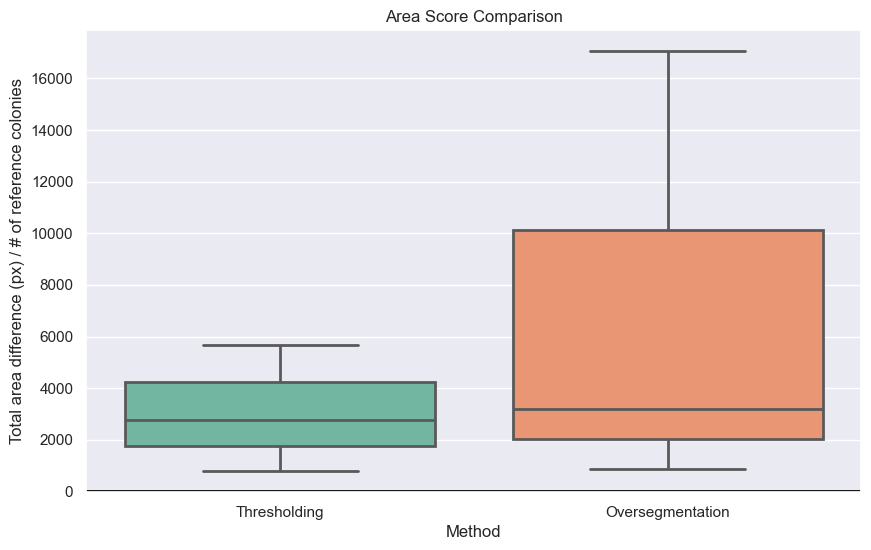

/var/folders/mr/2x3r3wwj1_s8k4v13ffh493h0000gr/T/ipykernel_35564/3948511655.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax2 = sns.boxplot(x="Method", y="Total centroid offset (px) / # of reference colonies", data=data, linewidth=2, palette="Set2")


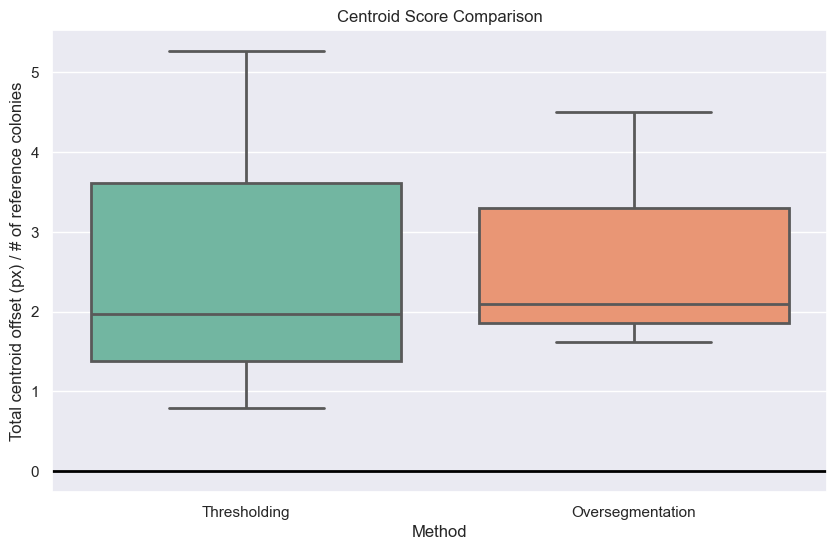

/var/folders/mr/2x3r3wwj1_s8k4v13ffh493h0000gr/T/ipykernel_35564/3948511655.py:28: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax3 = sns.boxplot(x="Method", y="Colony Count Delta / # of reference colonies", data=data, linewidth=2, palette="Set2")


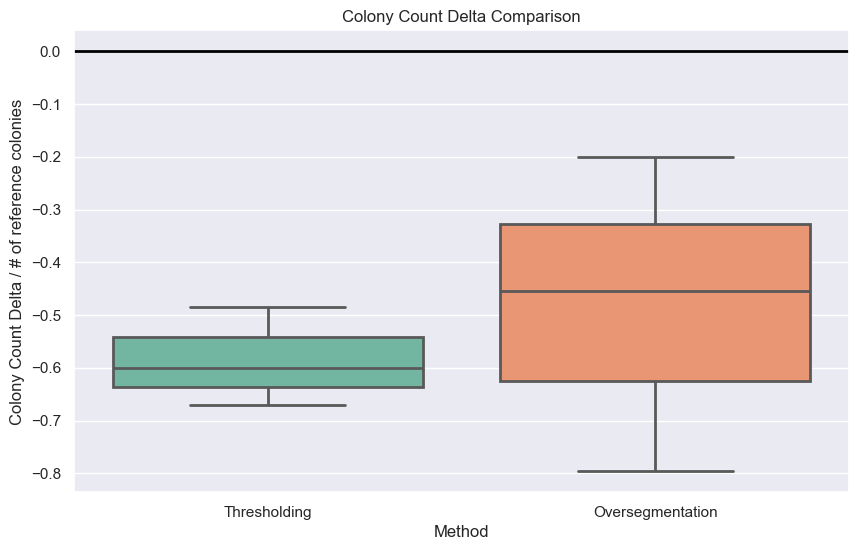

In [538]:
import seaborn as sns
import pandas as pd
sns.set_theme(rc={'figure.figsize':(8, 6)})

# Prepare the data for plotting
data = pd.DataFrame({
  "Total area difference (px) / # of reference colonies": area_score[0] + area_score[1],
  "Total centroid offset (px) / # of reference colonies": centroid_score[0] + centroid_score[1],
  "Colony Count Delta / # of reference colonies": colony_count_delta[0] + colony_count_delta[1],
  "Method": ["Thresholding"] * len(area_score[0]) + ["Oversegmentation"] * len(area_score[1])
})
# Plot Area Score
plt.figure(figsize=(10, 6))
ax1 = sns.boxplot(x="Method", y="Total area difference (px) / # of reference colonies", data=data, linewidth=2, palette="Set2")
ax1.set(title="Area Score Comparison")
plt.axhline(y=0, color='black', linewidth=2)
plt.show()

# Plot Centroid Score
plt.figure(figsize=(10, 6))
ax2 = sns.boxplot(x="Method", y="Total centroid offset (px) / # of reference colonies", data=data, linewidth=2, palette="Set2")
ax2.set(title="Centroid Score Comparison")
plt.axhline(y=0, color='black', linewidth=2)
plt.show()

# Plot Colony Count Delta
plt.figure(figsize=(10, 6))
ax3 = sns.boxplot(x="Method", y="Colony Count Delta / # of reference colonies", data=data, linewidth=2, palette="Set2")
ax3.set(title="Colony Count Delta Comparison")
plt.axhline(y=0, color='black', linewidth=2)
plt.show()
